In [60]:
import os, glob
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import cv2
import tifffile as tiff 
import json, zlib, base64
from PIL import Image

In [ ]:
############VER1############

In [43]:
DATA_DIR = "/Users/jiehyun/kaggle/input/hubmap-organ-segmentation/train_images"

In [50]:
im = Image.open(DATA_DIR + '/62.tiff')
#im.show()

In [52]:
im2 = cv2.imread(DATA_DIR + '/62.tiff')

print(type(im2))
# <class 'numpy.ndarray'>

print(im2.shape)
print(type(im2.shape))

<class 'numpy.ndarray'>
(3000, 3000, 3)
<class 'tuple'>


In [54]:
#img = np.zeros([3000,3000,3],dtype=np.uint8)
#img.fill(0)
#img_wht = Image.fromarray(img) #convert numpy array to image
#img_wht.show()

In [ ]:
###########VER2############

In [57]:
def base64_2_mask(s):
    z = zlib.decompress(base64.b64decode(s))
    n = np.fromstring(z, np.uint8)
    mask = cv2.imdecode(n, cv2.IMREAD_UNCHANGED)[:, :, 3].astype(bool)
    return mask

def mask_2_base64(mask):
    img_pil = Image.fromarray(np.array(mask, dtype=np.uint8))
    img_pil.putpalette([0,0,0,255,255,255])
    bytes_io = io.BytesIO()
    img_pil.save(bytes_io, format='PNG', transparency=0, optimize=0)
    bytes = bytes_io.getvalue()
    return base64.b64encode(zlib.compress(bytes)).decode('utf-8')

In [58]:
with open('/Users/jiehyun/kaggle/input/hubmap-organ-segmentation/train_annotations/62.json') as json_file:
    labels = json.load(json_file)

In [59]:
labels

[[[1539, 2010],
  [1538, 2011],
  [1531, 2011],
  [1530, 2012],
  [1526, 2012],
  [1525, 2013],
  [1516, 2013],
  [1515, 2014],
  [1507, 2014],
  [1506, 2015],
  [1505, 2015],
  [1504, 2016],
  [1503, 2016],
  [1502, 2017],
  [1499, 2017],
  [1497, 2019],
  [1496, 2019],
  [1495, 2020],
  [1492, 2020],
  [1491, 2021],
  [1489, 2021],
  [1487, 2023],
  [1485, 2023],
  [1484, 2024],
  [1483, 2024],
  [1481, 2026],
  [1479, 2026],
  [1478, 2027],
  [1477, 2027],
  [1476, 2028],
  [1476, 2029],
  [1470, 2035],
  [1470, 2036],
  [1466, 2040],
  [1466, 2041],
  [1464, 2043],
  [1464, 2044],
  [1463, 2045],
  [1463, 2047],
  [1462, 2048],
  [1462, 2049],
  [1461, 2050],
  [1461, 2054],
  [1460, 2055],
  [1460, 2077],
  [1461, 2078],
  [1461, 2083],
  [1462, 2084],
  [1462, 2091],
  [1463, 2092],
  [1463, 2101],
  [1464, 2102],
  [1464, 2109],
  [1465, 2110],
  [1465, 2114],
  [1466, 2115],
  [1466, 2117],
  [1467, 2118],
  [1467, 2119],
  [1468, 2120],
  [1468, 2122],
  [1469, 2123],
  [1469,

In [74]:
input_file = '/Users/jiehyun/kaggle/input/hubmap-organ-segmentation/train.csv'
dataset = pd.read_csv(input_file)
df = pd.DataFrame(dataset)
df = df["rle"][0]
df

'1459676 77 1462675 82 1465674 87 1468673 92 1471671 97 1474669 101 1477667 105 1480665 109 1483664 115 1486662 119 1489661 121 1492659 125 1495658 127 1498656 131 1501655 133 1504653 137 1507652 139 1510651 140 1513650 142 1516649 143 1519648 145 1522647 146 1525646 148 1528645 149 1531644 151 1534643 152 1537642 153 1540641 155 1543640 156 1546639 157 1549638 158 1552637 160 1555636 161 1558635 162 1561634 163 1564633 165 1567631 167 1570628 171 1573625 175 1576622 179 1579620 182 1582619 184 1585618 186 1588617 188 1591616 190 1594615 191 1597615 191 1600614 192 1603613 193 1606612 194 1609611 195 1612610 196 1615609 197 1618607 200 1621606 202 1624604 205 1627603 207 1630601 211 1633600 213 1636599 215 1639597 218 1642596 220 1645594 223 1648592 226 1651590 228 1654588 230 1657586 232 1660584 234 1663582 236 1666580 238 1669578 240 1672577 241 1675576 242 1678575 244 1681574 245 1684573 246 1687572 248 1690571 249 1693570 250 1696569 252 1699568 253 1702567 254 1705566 256 1708566 

In [83]:
df1 = list(map(int, df.split(' ')))
df1

[1459676,
 77,
 1462675,
 82,
 1465674,
 87,
 1468673,
 92,
 1471671,
 97,
 1474669,
 101,
 1477667,
 105,
 1480665,
 109,
 1483664,
 115,
 1486662,
 119,
 1489661,
 121,
 1492659,
 125,
 1495658,
 127,
 1498656,
 131,
 1501655,
 133,
 1504653,
 137,
 1507652,
 139,
 1510651,
 140,
 1513650,
 142,
 1516649,
 143,
 1519648,
 145,
 1522647,
 146,
 1525646,
 148,
 1528645,
 149,
 1531644,
 151,
 1534643,
 152,
 1537642,
 153,
 1540641,
 155,
 1543640,
 156,
 1546639,
 157,
 1549638,
 158,
 1552637,
 160,
 1555636,
 161,
 1558635,
 162,
 1561634,
 163,
 1564633,
 165,
 1567631,
 167,
 1570628,
 171,
 1573625,
 175,
 1576622,
 179,
 1579620,
 182,
 1582619,
 184,
 1585618,
 186,
 1588617,
 188,
 1591616,
 190,
 1594615,
 191,
 1597615,
 191,
 1600614,
 192,
 1603613,
 193,
 1606612,
 194,
 1609611,
 195,
 1612610,
 196,
 1615609,
 197,
 1618607,
 200,
 1621606,
 202,
 1624604,
 205,
 1627603,
 207,
 1630601,
 211,
 1633600,
 213,
 1636599,
 215,
 1639597,
 218,
 1642596,
 220,
 1645594,
 22

In [84]:
pixel,pixel_count = [],[]
[pixel.append(df1[i]) if i%2==0 else pixel_count.append(df1[i]) for i in range(0, len(df1))]
print('pixel starting points:\n',pixel)
print('pixel counting:\n', pixel_count)

pixel starting points:
 [1459676, 1462675, 1465674, 1468673, 1471671, 1474669, 1477667, 1480665, 1483664, 1486662, 1489661, 1492659, 1495658, 1498656, 1501655, 1504653, 1507652, 1510651, 1513650, 1516649, 1519648, 1522647, 1525646, 1528645, 1531644, 1534643, 1537642, 1540641, 1543640, 1546639, 1549638, 1552637, 1555636, 1558635, 1561634, 1564633, 1567631, 1570628, 1573625, 1576622, 1579620, 1582619, 1585618, 1588617, 1591616, 1594615, 1597615, 1600614, 1603613, 1606612, 1609611, 1612610, 1615609, 1618607, 1621606, 1624604, 1627603, 1630601, 1633600, 1636599, 1639597, 1642596, 1645594, 1648592, 1651590, 1654588, 1657586, 1660584, 1663582, 1666580, 1669578, 1672577, 1675576, 1678575, 1681574, 1684573, 1687572, 1690571, 1693570, 1696569, 1699568, 1702567, 1705566, 1708566, 1711565, 1714564, 1717563, 1720562, 1723562, 1726561, 1729561, 1732560, 1735560, 1738559, 1741559, 1744558, 1747556, 1750554, 1753552, 1756550, 1759548, 1762547, 1765545, 1768543, 1771541, 1774539, 1777538, 1780536, 178

In [85]:
rle_pixels = [list(range(pixel[i],pixel[i]+pixel_count[i])) for i in range(0, len(pixel))]
print('rle_pixels\n:', rle_pixels)

rle_pixels
: [[1459676, 1459677, 1459678, 1459679, 1459680, 1459681, 1459682, 1459683, 1459684, 1459685, 1459686, 1459687, 1459688, 1459689, 1459690, 1459691, 1459692, 1459693, 1459694, 1459695, 1459696, 1459697, 1459698, 1459699, 1459700, 1459701, 1459702, 1459703, 1459704, 1459705, 1459706, 1459707, 1459708, 1459709, 1459710, 1459711, 1459712, 1459713, 1459714, 1459715, 1459716, 1459717, 1459718, 1459719, 1459720, 1459721, 1459722, 1459723, 1459724, 1459725, 1459726, 1459727, 1459728, 1459729, 1459730, 1459731, 1459732, 1459733, 1459734, 1459735, 1459736, 1459737, 1459738, 1459739, 1459740, 1459741, 1459742, 1459743, 1459744, 1459745, 1459746, 1459747, 1459748, 1459749, 1459750, 1459751, 1459752], [1462675, 1462676, 1462677, 1462678, 1462679, 1462680, 1462681, 1462682, 1462683, 1462684, 1462685, 1462686, 1462687, 1462688, 1462689, 1462690, 1462691, 1462692, 1462693, 1462694, 1462695, 1462696, 1462697, 1462698, 1462699, 1462700, 1462701, 1462702, 1462703, 1462704, 1462705, 1462706, 14

In [86]:
rle_mask_pixels = sum(rle_pixels,[]) 
print('rle mask pixels:\n', rle_mask_pixels)

rle mask pixels:
 [1459676, 1459677, 1459678, 1459679, 1459680, 1459681, 1459682, 1459683, 1459684, 1459685, 1459686, 1459687, 1459688, 1459689, 1459690, 1459691, 1459692, 1459693, 1459694, 1459695, 1459696, 1459697, 1459698, 1459699, 1459700, 1459701, 1459702, 1459703, 1459704, 1459705, 1459706, 1459707, 1459708, 1459709, 1459710, 1459711, 1459712, 1459713, 1459714, 1459715, 1459716, 1459717, 1459718, 1459719, 1459720, 1459721, 1459722, 1459723, 1459724, 1459725, 1459726, 1459727, 1459728, 1459729, 1459730, 1459731, 1459732, 1459733, 1459734, 1459735, 1459736, 1459737, 1459738, 1459739, 1459740, 1459741, 1459742, 1459743, 1459744, 1459745, 1459746, 1459747, 1459748, 1459749, 1459750, 1459751, 1459752, 1462675, 1462676, 1462677, 1462678, 1462679, 1462680, 1462681, 1462682, 1462683, 1462684, 1462685, 1462686, 1462687, 1462688, 1462689, 1462690, 1462691, 1462692, 1462693, 1462694, 1462695, 1462696, 1462697, 1462698, 1462699, 1462700, 1462701, 1462702, 1462703, 1462704, 1462705, 1462706, 

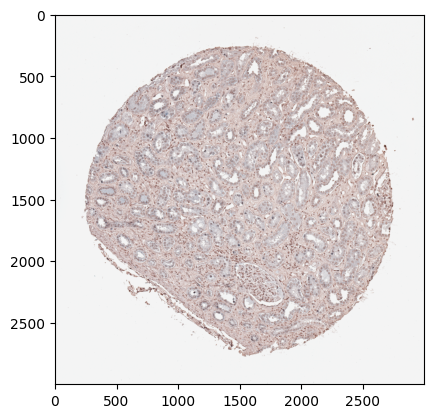

In [98]:
plt.imshow(cv2.imread(DATA_DIR + '/62.tiff'))

In [99]:
mask_img = np.zeros((3000*3000,1), dtype=int)

In [100]:
mask_img[rle_mask_pixels] = 0

In [101]:
l,b=cv2.imread(DATA_DIR + '/62.tiff').shape[0], cv2.imread(DATA_DIR + '/62.tiff').shape[1]
mask = np.reshape(mask_img, (b, l)).T

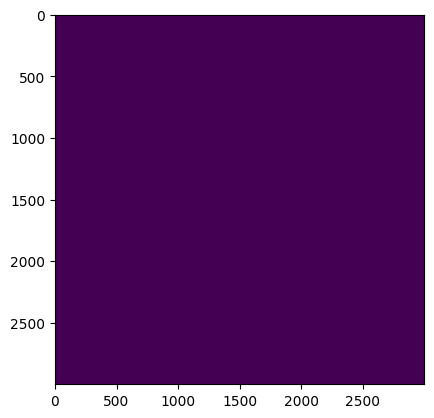

In [102]:
plt.imshow(mask)

In [ ]:
########VER3############

In [106]:
def rle_decode(mask_rle: str, img_shape: tuple = None) -> np.ndarray:
    seq = mask_rle.split()
    starts = np.array(list(map(int, seq[0::2])))
    lengths = np.array(list(map(int, seq[1::2])))
    assert len(starts) == len(lengths)
    ends = starts + lengths
    img = np.zeros((np.product(img_shape),), dtype=np.uint8)
    for begin, end in zip(starts, ends):
        img[begin:end] = 1
    # https://stackoverflow.com/a/46574906/4521646
    img.shape = img_shape
    return img

In [111]:
from skimage import color
from kaggle_imsegm.mask import rle_encode

<generator object DataFrame.iterrows at 0x289d209e0>


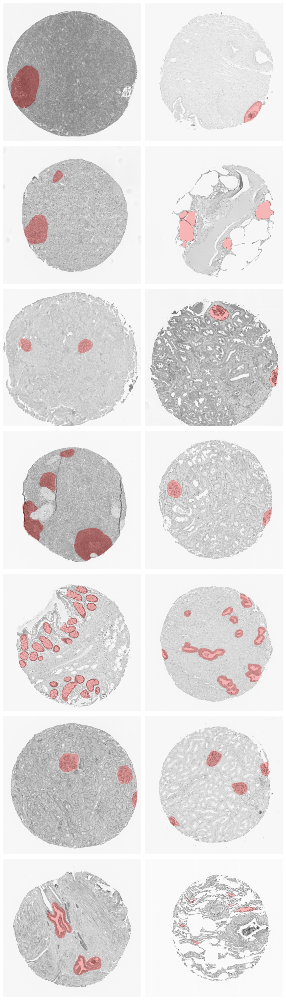

In [147]:
DATASET_FOLDER = "/Users/jiehyun/kaggle/input/hubmap-organ-segmentation/"
df_train = pd.read_csv("/Users/jiehyun/kaggle/input/hubmap-organ-segmentation/train.csv")
fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(9, 30))
for i, (_, row) in enumerate(df_train.sample(14).iterrows()):
    img = plt.imread(os.path.join(DATASET_FOLDER, "train_images", f"{row['id']}.tiff"))
    mask = rle_decode(row['rle'], img_shape=(row["img_height"], row["img_width"])).T
    axes[i // 2, i % 2].imshow(color.label2rgb(mask, img, bg_label=0, bg_color=(1.,1.,1.), alpha=0.25))
    axes[i // 2, i % 2].set_axis_off()
    rle = rle_encode(mask.T)
    assert row['rle'] == rle[1]
fig.tight_layout()

In [ ]:
#####VER4##########

In [133]:
df2 = pd.read_csv(
    os.path.join(DATASET_FOLDER, "train.csv")
)

In [134]:
img_id_1 = 62
img_1 = tiff.imread(DATASET_FOLDER + "train_images/" + str(img_id_1) + ".tiff")
print(img_1.shape)

(3000, 3000, 3)


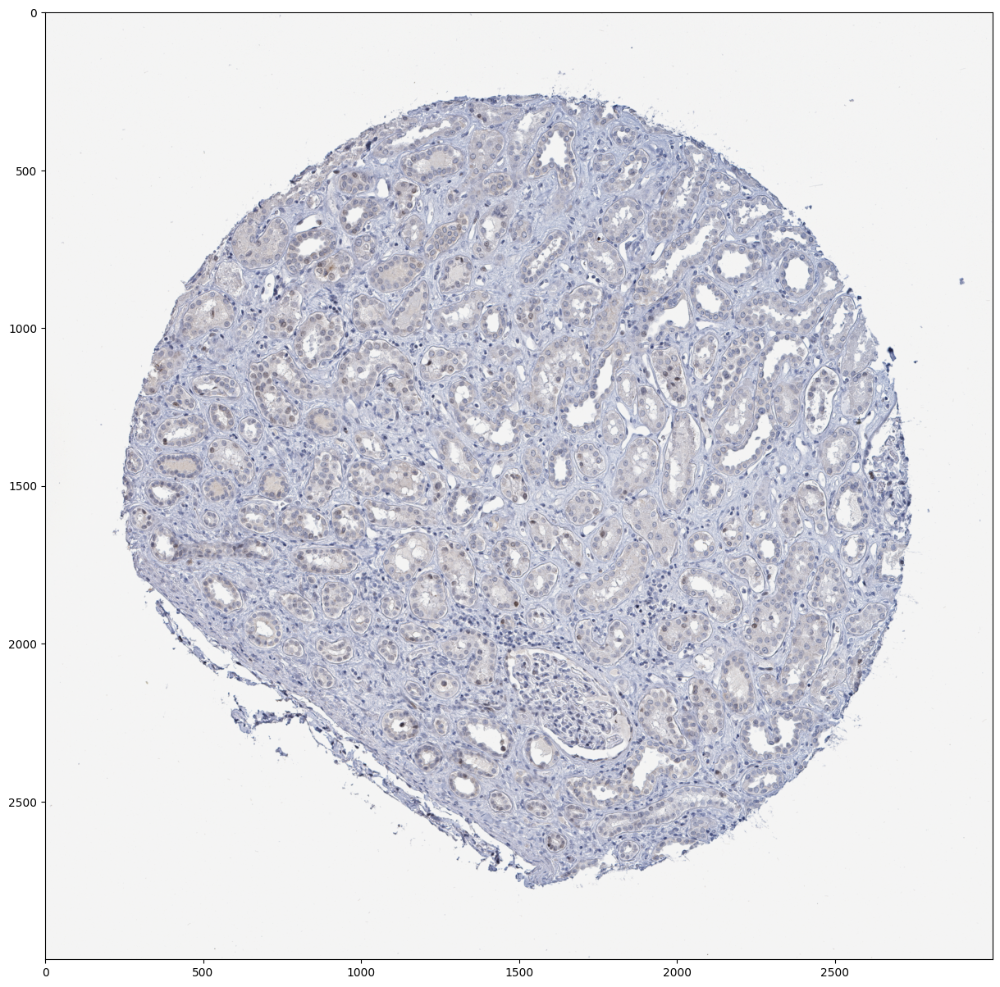

In [135]:
plt.figure(figsize=(15, 15))
plt.imshow(img_1)

In [136]:
# https://www.kaggle.com/paulorzp/rle-functions-run-length-encode-decode
def mask2rle(img):
    '''
    img: numpy array, 1 - mask, 0 - background
    Returns run length as string formated
    '''
    pixels= img.T.flatten()
    pixels = np.concatenate([[0], pixels, [0]])
    runs = np.where(pixels[1:] != pixels[:-1])[0] + 1
    runs[1::2] -= runs[::2]
    return ' '.join(str(x) for x in runs)
 
def rle2mask(mask_rle, shape=(1600,256)):
    '''
    mask_rle: run-length as string formated (start length)
    shape: (width,height) of array to return 
    Returns numpy array, 1 - mask, 0 - background

    '''
    s = mask_rle.split()
    starts, lengths = [np.asarray(x, dtype=int) for x in (s[0:][::2], s[1:][::2])]
    starts -= 1
    ends = starts + lengths
    img = np.zeros(shape[0]*shape[1], dtype=np.uint8)
    for lo, hi in zip(starts, ends):
        img[lo:hi] = 1
    return img.reshape(shape).T

In [137]:
mask_1 = rle2mask(df2[df2["id"]==img_id_1]["rle"].iloc[-1], (img_1.shape[1], img_1.shape[0]))
mask_1.shape

(3000, 3000)

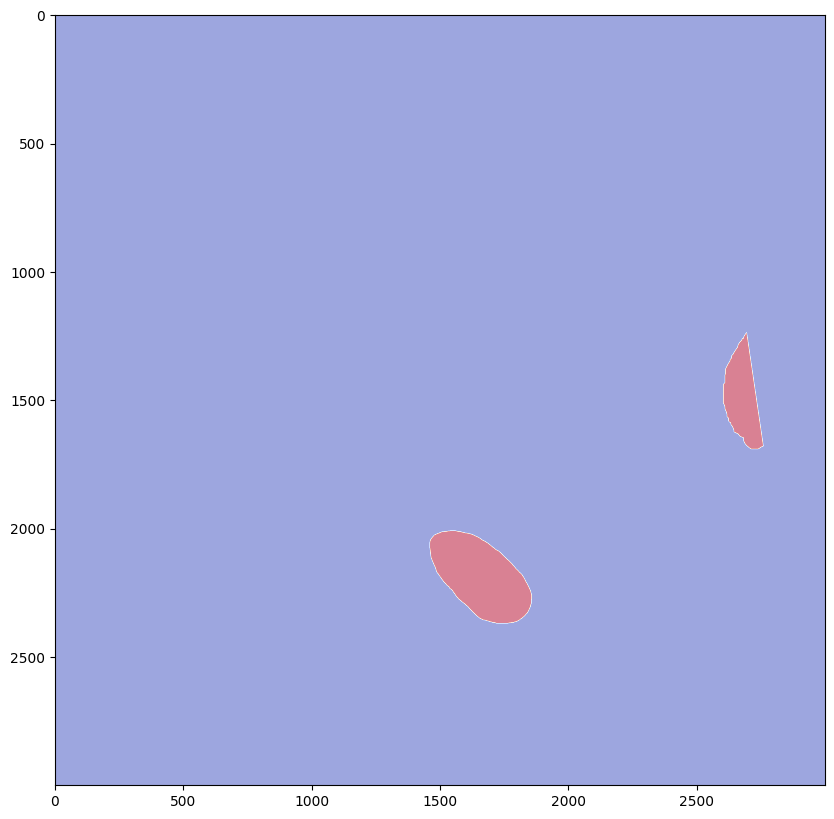

In [138]:
plt.figure(figsize=(10,10))
plt.imshow(mask_1, cmap='coolwarm', alpha=0.5)

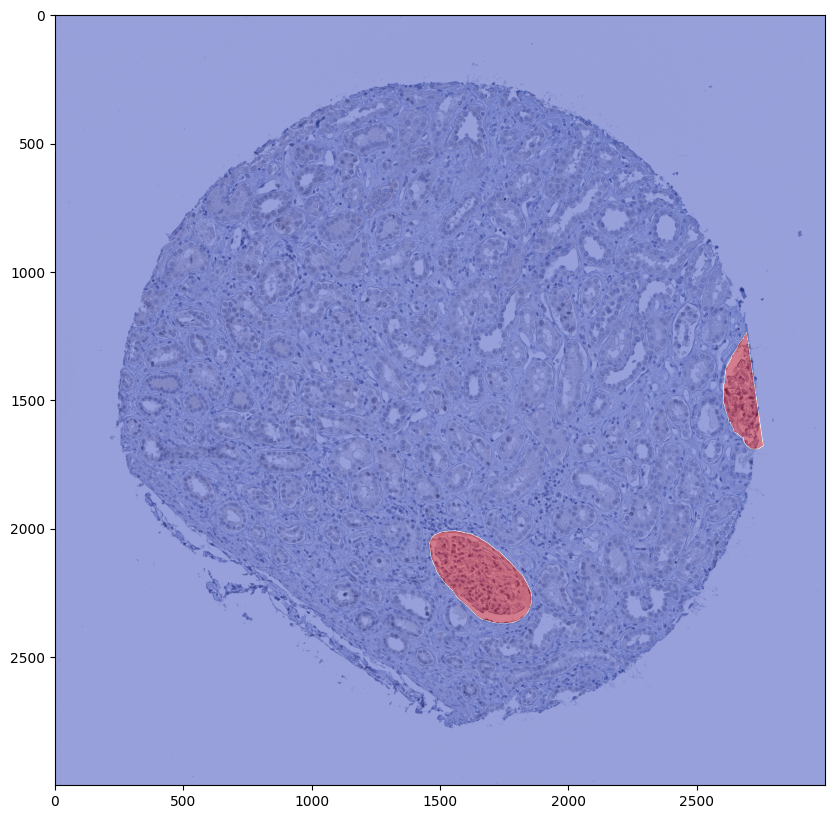

In [139]:
plt.figure(figsize=(10,10))
plt.imshow(img_1)
plt.imshow(mask_1, cmap='coolwarm', alpha=0.5)

In [195]:
DATASET_FOLDER = "/Users/jiehyun/kaggle/input/hubmap-organ-segmentation/"
df_train = pd.read_csv("/Users/jiehyun/kaggle/input/hubmap-organ-segmentation/train.csv")

df_lung = df_train.loc[df_train["organ"] == 'lung']
df_lung

,id,organ,data_source,img_height,img_width,pixel_size,tissue_thickness,rle,age,sex
3,10488,lung,HPA,3000,3000,0.4,4,3446519 15 3449517 17 3452514 20 3455510 24 34...,78.0,Male
13,11064,lung,HPA,3000,3000,0.4,4,2210040 68 2213039 70 2216036 74 2219032 79 22...,65.0,Male
18,11629,lung,HPA,3000,3000,0.4,4,4143554 1 4146554 2 4149554 3 4152555 3 415555...,43.0,Female
26,1220,lung,HPA,3000,3000,0.4,4,1429797 16 1432793 21 1435791 23 1438789 27 14...,59.0,Male
30,12452,lung,HPA,3000,3000,0.4,4,4648688 22 4651675 37 4654675 39 4657670 48 46...,78.0,Male
33,12476,lung,HPA,3000,3000,0.4,4,2783561 23 2786559 26 2789558 28 2792556 31 27...,21.0,Male
35,127,lung,HPA,3000,3000,0.4,4,4237495 6 4240494 9 4243491 14 4246490 17 4249...,21.0,Male
37,12827,lung,HPA,3000,3000,0.4,4,3210652 9 3213650 16 3216647 21 3219645 24 322...,57.0,Female
39,13189,lung,HPA,3000,3000,0.4,4,1844328 7 1847327 10 1850270 27 1850326 13 185...,21.0,Male
46,14388,lung,HPA,3000,3000,0.4,4,2059356 15 2062356 16 2065352 25 2068350 29 20...,78.0,Male


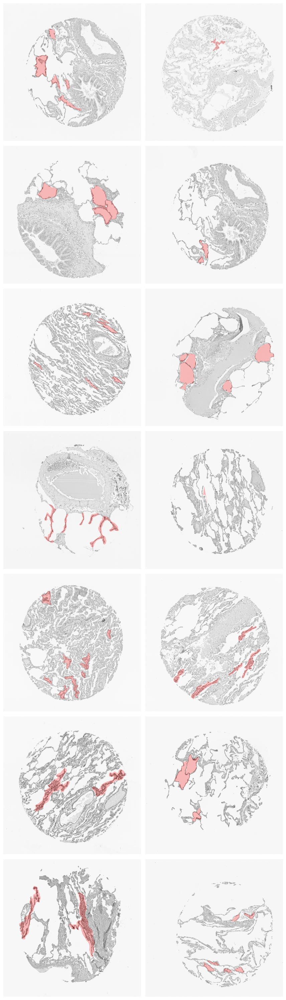

In [196]:
fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(9, 30))
for i, (_, row) in enumerate(df_lung.sample(14).iterrows()):
    img = plt.imread(os.path.join(DATASET_FOLDER, "train_images", f"{row['id']}.tiff"))
    mask = rle_decode(row['rle'], img_shape=(row["img_height"], row["img_width"])).T
    axes[i // 2, i % 2].imshow(color.label2rgb(mask, img, bg_label=0, bg_color=(1.,1.,1.), alpha=0.25))
    axes[i // 2, i % 2].set_axis_off()
    rle = rle_encode(mask.T)
    assert row['rle'] == rle[1]
fig.tight_layout()

In [185]:
DATASET_FOLDER = "/Users/jiehyun/kaggle/input/hubmap-organ-segmentation/"
df_train = pd.read_csv("/Users/jiehyun/kaggle/input/hubmap-organ-segmentation/train.csv")

df_pro = df_train.loc[df_train["organ"] == 'prostate']
df_pro

,id,organ,data_source,img_height,img_width,pixel_size,tissue_thickness,rle,age,sex
0,10044,prostate,HPA,3000,3000,0.4,4,1459676 77 1462675 82 1465674 87 1468673 92 14...,37.0,Male
1,10274,prostate,HPA,3000,3000,0.4,4,715707 2 718705 8 721703 11 724701 18 727692 3...,76.0,Male
7,10666,prostate,HPA,3000,3000,0.4,4,2698231 7 2701231 7 2704226 16 2707221 25 2710...,57.0,Male
10,10912,prostate,HPA,3000,3000,0.4,4,1147323 50 1150316 59 1153309 68 1156303 76 11...,60.0,Male
11,10971,prostate,HPA,3000,3000,0.4,4,1507862 60 1510857 69 1513853 77 1516848 86 15...,60.0,Male
...,...,...,...,...,...,...,...,...,...,...
331,8638,prostate,HPA,3000,3000,0.4,4,3312310 10 3315310 11 3318301 25 3321299 27 33...,48.0,Male
333,8842,prostate,HPA,3000,3000,0.4,4,1430055 19 1430115 36 1433053 21 1433114 38 14...,61.0,Male
336,9231,prostate,HPA,3000,3000,0.4,4,1048080 26 1051079 28 1054078 30 1057071 39 10...,55.0,Male
337,928,prostate,HPA,3000,3000,0.4,4,1980656 1 1980673 27 1981666 48 1983655 1 1983...,55.0,Male


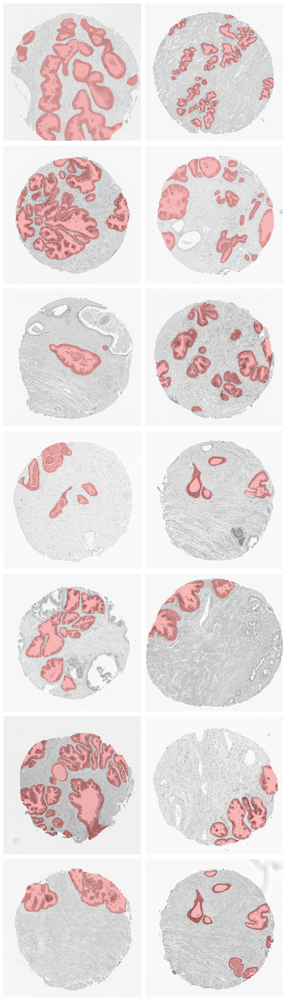

In [186]:
fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(9, 30))
for i, (_, row) in enumerate(df_pro.sample(14).iterrows()):
    img = plt.imread(os.path.join(DATASET_FOLDER, "train_images", f"{row['id']}.tiff"))
    mask = rle_decode(row['rle'], img_shape=(row["img_height"], row["img_width"])).T
    axes[i // 2, i % 2].imshow(color.label2rgb(mask, img, bg_label=0, bg_color=(1.,1.,1.), alpha=0.25))
    axes[i // 2, i % 2].set_axis_off()
    rle = rle_encode(mask.T)
    assert row['rle'] == rle[1]
fig.tight_layout()

In [187]:
df_spleen = df_train.loc[df_train["organ"] == 'spleen']
df_spleen

,id,organ,data_source,img_height,img_width,pixel_size,tissue_thickness,rle,age,sex
2,10392,spleen,HPA,3000,3000,0.4,4,1228631 20 1231629 24 1234624 40 1237623 47 12...,82.0,Male
4,10610,spleen,HPA,3000,3000,0.4,4,478925 68 481909 87 484893 105 487863 154 4908...,21.0,Female
8,10703,spleen,HPA,3000,3000,0.4,4,811259 262 814258 264 817257 266 820256 267 82...,50.0,Female
12,10992,spleen,HPA,3000,3000,0.4,4,2245542 37 2248540 41 2251534 53 2254533 55 22...,74.0,Female
14,1123,spleen,HPA,3000,3000,0.4,4,2852439 100 2855436 106 2858434 110 2861421 13...,21.0,Female
15,11448,spleen,HPA,3000,3000,0.4,4,3450282 28 3453278 33 3456272 53 3459271 56 34...,21.0,Female
19,11645,spleen,HPA,2867,2867,0.4,4,1971766 32 1974633 34 1977499 36 1980366 37 19...,74.0,Female
24,12026,spleen,HPA,3000,3000,0.4,4,568261 32 571258 36 574256 38 577245 61 580243...,57.0,Male
31,12466,spleen,HPA,3000,3000,0.4,4,920222 4 923221 6 926221 6 929220 10 932218 14...,74.0,Female
34,12483,spleen,HPA,3000,3000,0.4,4,3358269 61 3361268 64 3364267 67 3367247 89 33...,72.0,Male


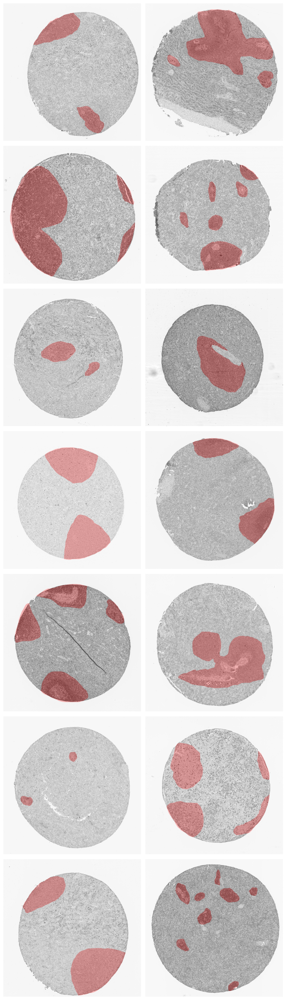

In [188]:
fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(9, 30))
for i, (_, row) in enumerate(df_spleen.sample(14).iterrows()):
    img = plt.imread(os.path.join(DATASET_FOLDER, "train_images", f"{row['id']}.tiff"))
    mask = rle_decode(row['rle'], img_shape=(row["img_height"], row["img_width"])).T
    axes[i // 2, i % 2].imshow(color.label2rgb(mask, img, bg_label=0, bg_color=(1.,1.,1.), alpha=0.25))
    axes[i // 2, i % 2].set_axis_off()
    rle = rle_encode(mask.T)
    assert row['rle'] == rle[1]
fig.tight_layout()

In [191]:
df_intestine = df_train.loc[df_train["organ"] == 'largeintestine']
df_intestine

,id,organ,data_source,img_height,img_width,pixel_size,tissue_thickness,rle,age,sex
6,10651,largeintestine,HPA,3000,3000,0.4,4,1240229 12 1243227 15 1246223 26 1249221 29 12...,83.0,Male
9,10892,largeintestine,HPA,3000,3000,0.4,4,523786 3 526784 8 529782 8 532778 9 535642 25 ...,79.0,Female
20,11662,largeintestine,HPA,3000,3000,0.4,4,673655 29 676649 41 679645 47 682638 59 685636...,84.0,Female
21,1168,largeintestine,HPA,3000,3000,0.4,4,652348 27 655344 35 658310 79 661305 93 664303...,84.0,Male
23,11890,largeintestine,HPA,3000,3000,0.4,4,1297230 32 1300222 46 1303215 60 1306213 63 13...,79.0,Female
25,12174,largeintestine,HPA,3000,3000,0.4,4,592530 6 595511 36 598506 43 601493 63 604487 ...,83.0,Male
32,12471,largeintestine,HPA,3000,3000,0.4,4,472548 109 475547 111 478539 2 478546 118 4815...,84.0,Female
41,13396,largeintestine,HPA,3000,3000,0.4,4,1306024 34 1309000 2 1309015 50 1311998 6 1312...,83.0,Male
43,13507,largeintestine,HPA,3000,3000,0.4,4,781338 33 784331 46 787329 56 790327 60 793324...,83.0,Male
45,14183,largeintestine,HPA,3000,3000,0.4,4,214358 9 214393 17 217355 14 217383 39 220354 ...,65.0,Female


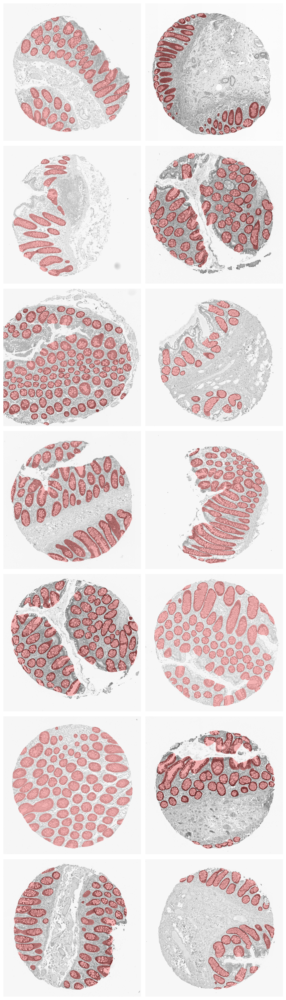

In [192]:
fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(9, 30))
for i, (_, row) in enumerate(df_intestine.sample(14).iterrows()):
    img = plt.imread(os.path.join(DATASET_FOLDER, "train_images", f"{row['id']}.tiff"))
    mask = rle_decode(row['rle'], img_shape=(row["img_height"], row["img_width"])).T
    axes[i // 2, i % 2].imshow(color.label2rgb(mask, img, bg_label=0, bg_color=(1.,1.,1.), alpha=0.25))
    axes[i // 2, i % 2].set_axis_off()
    rle = rle_encode(mask.T)
    assert row['rle'] == rle[1]
fig.tight_layout()

In [193]:
df_kidney = df_train.loc[df_train["organ"] == 'kidney']
df_kidney

,id,organ,data_source,img_height,img_width,pixel_size,tissue_thickness,rle,age,sex
5,10611,kidney,HPA,3000,3000,0.4,4,730193 18 733191 25 736191 25 739152 65 742149...,68.0,Female
16,11497,kidney,HPA,3000,3000,0.4,4,940436 51 943430 65 946427 76 949423 89 952417...,41.0,Female
17,1157,kidney,HPA,3000,3000,0.4,4,4883571 15 4886565 32 4889561 41 4892559 49 48...,73.0,Male
36,12784,kidney,HPA,2727,2727,0.4,4,2286990 33 2289716 37 2292442 39 2295167 41 22...,61.0,Male
38,13034,kidney,HPA,3000,3000,0.4,4,850253 18 853250 24 856245 32 859237 46 862233...,73.0,Male
...,...,...,...,...,...,...,...,...,...,...
342,9445,kidney,HPA,3000,3000,0.4,4,5515207 20 5518204 29 5521202 35 5524202 36 55...,28.0,Male
345,9470,kidney,HPA,3000,3000,0.4,4,3969980 35 3970027 28 3972971 88 3975966 97 39...,61.0,Male
346,9517,kidney,HPA,3000,3000,0.4,4,1611763 11 1614753 29 1617750 35 1620746 43 16...,61.0,Male
347,9769,kidney,HPA,3070,3070,0.4,4,4030400 28 4033466 34 4036526 48 4039594 54 40...,28.0,Male


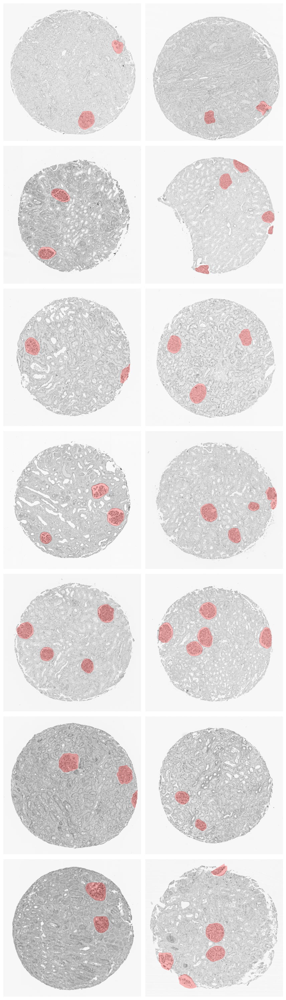

In [194]:
fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(9, 30))
for i, (_, row) in enumerate(df_kidney.sample(14).iterrows()):
    img = plt.imread(os.path.join(DATASET_FOLDER, "train_images", f"{row['id']}.tiff"))
    mask = rle_decode(row['rle'], img_shape=(row["img_height"], row["img_width"])).T
    axes[i // 2, i % 2].imshow(color.label2rgb(mask, img, bg_label=0, bg_color=(1.,1.,1.), alpha=0.25))
    axes[i // 2, i % 2].set_axis_off()
    rle = rle_encode(mask.T)
    assert row['rle'] == rle[1]
fig.tight_layout()